# Evaluation: case study

This notebook visualises the nowcast case study for 07 June 2024.

In [ ]:
import os
import copy

import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cf
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

from dustcast.evaluation.io import load_background_rgb_from_file, load_nowcast_from_file
from dustcast.evaluation.mask import get_ct_mask, get_du_mask
from dustcast.features.rgb import bt_to_rgb, resize_image

## Configuration and data loading

Set up file paths for background imagery

In [ ]:
ifnm_ncst = './west-africa/full-eval/20240607-1700.nc'
idir_btbg = './west-africa/seviri_15dmean_cs'

Load nowcast data.

In [ ]:
inp_bt, prd_bt, obs_bt, flag_obs, time_input, time_valid, time_init, lat, lon = load_nowcast_from_file(ifnm_ncst)

Load cloud screened 15-day mean background brightness temperatures.

In [ ]:
rgb_bg = load_background_rgb_from_file(idir_btbg, time_init)

Prepare for plotting.

In [5]:
# Resize background image to match nowcast image size
img_size = obs_bt.shape[-1]
rgb_bg = resize_image(rgb_bg, (img_size, img_size))       

# Convert brightness temperature predictions to RGB images
img_inp = bt_to_rgb(inp_bt, gamma=[1.0, 2.5, 1.0], lims = [[-4,2],[0,15],[261,289]], channel_dim=1)
img_prd = bt_to_rgb(prd_bt, gamma=[1.0, 2.5, 1.0], lims = [[-4,2],[0,15],[261,289]], channel_dim=2)
img_obs = bt_to_rgb(obs_bt, gamma=[1.0, 2.5, 1.0], lims = [[-4,2],[0,15],[261,289]], channel_dim=1)
img_bg = bt_to_rgb(rgb_bg, gamma=[1.0, 2.5, 1.0], lims = [[-4,2],[0,15],[261,289]], channel_dim=0)

# Get binary feature masks
inp_mask_ct = get_ct_mask(inp_bt, channel_dim=1)
prd_mask_ct = get_ct_mask(prd_bt, channel_dim=2)
obs_mask_ct = get_ct_mask(obs_bt, channel_dim=1)
inp_mask_du = get_du_mask(inp_bt, rgb_bg, channel_dim=1)
prd_mask_du = get_du_mask(prd_bt, rgb_bg, channel_dim=2)
obs_mask_du = get_du_mask(obs_bt, rgb_bg, channel_dim=1)

# Set image extent
img_extent = [lon.min(), lon.max(), lat.min(), lat.max()]

In [6]:
print("Observation availability:")
print(f"flag_obs.shape: {flag_obs.shape}")
print(f"flag_obs: {flag_obs}\n")

print("Prediction data:")
print(f"prd_bt.shape: {prd_bt.shape}")
print("[frame, ens, channel, lat, lon]")

Observation availability:
flag_obs.shape: (24,)
flag_obs: [1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]

Prediction data:
prd_bt.shape: (24, 5, 3, 256, 256)
[frame, ens, channel, lat, lon]


# Plotting section

Set output directory.

In [7]:
plt_dir='./plt'

### Latest input, observation, forecast

/home/users/khermes/miniconda3/envs/rgb-nowcast/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


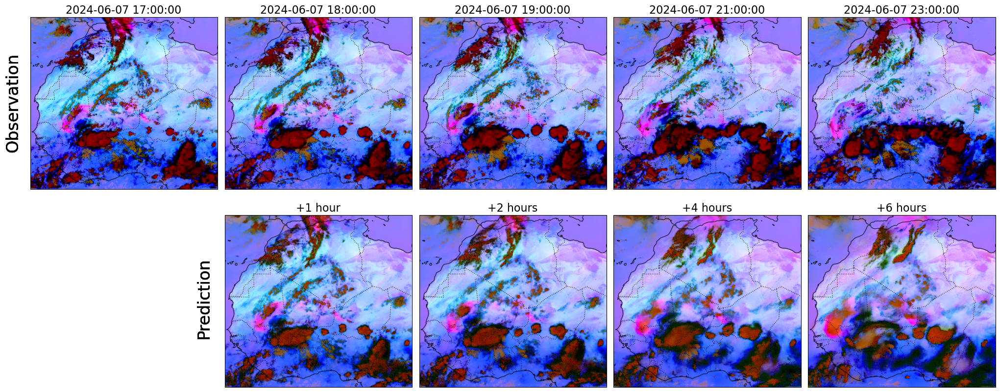

In [8]:
ens = 0
plt_steps = [3, 7, 15, 23]  # Indices of the images to plot

# Define the figure and axes for the two-row plot
fig, axes = plt.subplots(2, 5, figsize=(20, 8.5), subplot_kw={'projection': ccrs.PlateCarree()})  # 2 rows, 4 columns

# Update titles to include step numbers for bottom_titles
top_titles = [time_init] + [f'{time_valid[i]}' for i in plt_steps]
# bottom_titles = ['None'] + [f'+ {(i+1)*15} minutes' for i in plt_steps]
bottom_titles = ['None', '+1 hour', '+2 hours', '+4 hours', '+6 hours']

# Images for the top and bottom rows
top_images = [img_inp[-1], img_obs[plt_steps[0]], img_obs[plt_steps[1]], img_obs[plt_steps[2]], img_obs[plt_steps[3]]]
bottom_images = [None, img_prd[plt_steps[0]][ens], img_prd[plt_steps[1]][ens], img_prd[plt_steps[2]][ens], img_prd[plt_steps[3]][ens]]
# Plot the top row
for ax, img, title in zip(axes[0], top_images, top_titles):
    if img is not None:
        ax.imshow(img, origin='upper', extent=img_extent, transform=ccrs.PlateCarree())
    ax.set_title(title, fontsize=16)
    ax.set_extent(img_extent, crs=ccrs.PlateCarree())
    ax.add_feature(cf.COASTLINE, alpha=0.75, color='black')
    ax.add_feature(cf.BORDERS, linestyle=':', alpha=0.75, color='black')

# Plot the bottom row
for ax, img, title in zip(axes[1], bottom_images, bottom_titles):
    if img is not None:
        ax.imshow(img, origin='upper', extent=img_extent, transform=ccrs.PlateCarree())
    ax.set_title(title, fontsize=16)
    ax.set_extent(img_extent, crs=ccrs.PlateCarree())
    ax.add_feature(cf.COASTLINE, alpha=0.75, color='black')
    ax.add_feature(cf.BORDERS, linestyle=':', alpha=0.75, color='black')

    fig.text(-0.01, 0.74, 'Observation', va='center', ha='center', rotation='vertical', fontsize=24)
    fig.text(0.185, 0.27, 'Prediction', va='center', ha='center', rotation='vertical', fontsize=24)

axes[1][0].remove()

plt.tight_layout()
plt.savefig(f'{plt_dir}/example_nowcast_obs_prd.png', dpi=150, bbox_inches='tight')
# plt.savefig(f'{plt_dir}/example_nowcast_obs_prd.pdf', bbox_inches='tight')

### Latest input, observation, forecast (full ensemble)

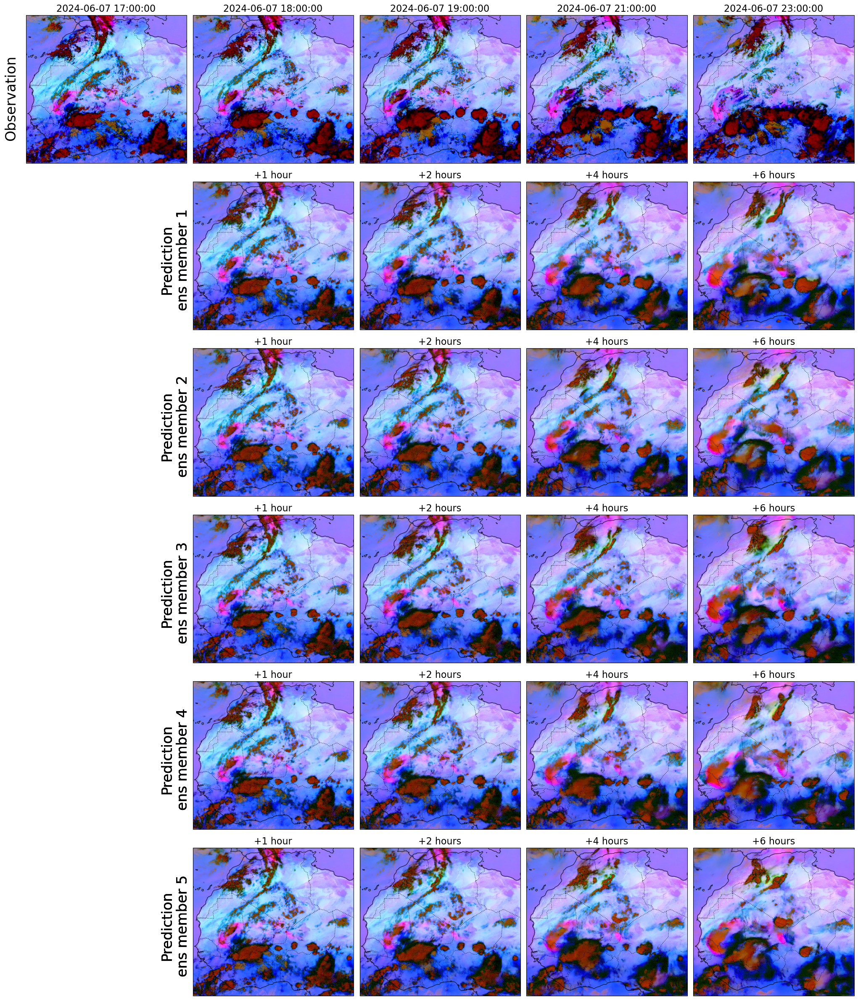

In [9]:
plt_steps = [3, 7, 15, 23]  # Indices of the images to plot

# Define the figure and axes for the two-row plot
fig, axes = plt.subplots(6, 5, figsize=(20, 24), subplot_kw={'projection': ccrs.PlateCarree()})  # 2 rows, 4 columns

# Update titles to include step numbers for bottom_titles
top_titles = [time_init] + [f'{time_valid[i]}' for i in plt_steps]
# bottom_titles = ['None'] + [f'+ {(i+1)*15} minutes' for i in plt_steps]
bottom_titles = ['None', '+1 hour', '+2 hours', '+4 hours', '+6 hours']

# Images for the top and bottom rows
top_images = [img_inp[-1], img_obs[plt_steps[0]], img_obs[plt_steps[1]], img_obs[plt_steps[2]], img_obs[plt_steps[3]]]
# Plot the top row
for ax, img, title in zip(axes[0], top_images, top_titles):
    if img is not None:
        ax.imshow(img, origin='upper', extent=img_extent, transform=ccrs.PlateCarree())
    ax.set_title(title, fontsize=16)
    ax.set_extent(img_extent, crs=ccrs.PlateCarree())
    ax.add_feature(cf.COASTLINE, alpha=0.75, color='black')
    ax.add_feature(cf.BORDERS, linestyle=':', alpha=0.75, color='black')
fig.text(-0.01, 0.9, 'Observation', va='center', ha='center', rotation='vertical', fontsize=24)

# Plot the bottom row
for ii in range(5):
    ens = ii
    bottom_images = [None, img_prd[plt_steps[0]][ens], img_prd[plt_steps[1]][ens], img_prd[plt_steps[2]][ens], img_prd[plt_steps[3]][ens]]
    for ax, img, title in zip(axes[1+ii], bottom_images, bottom_titles):
        if img is not None:
            ax.imshow(img, origin='upper', extent=img_extent, transform=ccrs.PlateCarree())
        ax.set_title(title, fontsize=16)
        ax.set_extent(img_extent, crs=ccrs.PlateCarree())
        ax.add_feature(cf.COASTLINE, alpha=0.75, color='black')
        ax.add_feature(cf.BORDERS, linestyle=':', alpha=0.75, color='black')

        fig.text(0.185, 0.74-ii*0.165, f'Prediction\nens member {ii+1}', va='center', ha='center', rotation='vertical', fontsize=24)

    axes[1+ii][0].remove()

# Adjust layout and display the plot
plt.tight_layout()
plt.savefig(os.path.join(plt_dir, 'example_nowcast_obs_prd_ens.png'), dpi=150, bbox_inches='tight')
# plt.savefig(os.path.join(plt_dir, 'example_nowcast_obs_prd_ens.pdf'), bbox_inches='tight')

### Latest input, observation, forecast (full ensemble, binary masks)

0
1
2
3
4


/home/users/khermes/miniconda3/envs/rgb-nowcast/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/home/users/khermes/miniconda3/envs/rgb-nowcast/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/home/users/khermes/miniconda3/envs/rgb-nowcast/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/home/users/khermes/miniconda3/envs/rgb-nowcast/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
/home/users/khermes/mini

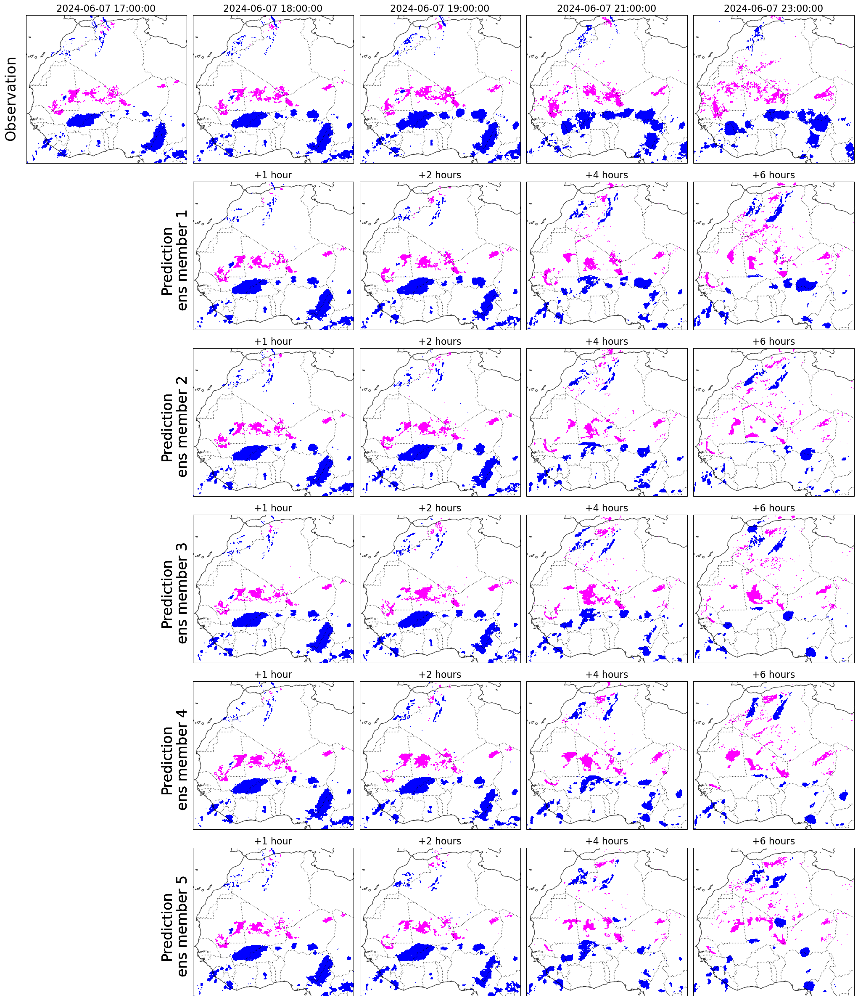

In [10]:
plt_steps = [3, 7, 15, 23]  # Indices of the images to plot

# Define the figure and axes for the two-row plot
fig, axes = plt.subplots(6, 5, figsize=(20, 24), subplot_kw={'projection': ccrs.PlateCarree()})  # 2 rows, 4 columns

# Update titles to include step numbers for bottom_titles
top_titles = [time_init] + [f'{time_valid[i]}' for i in plt_steps]
bottom_titles = ['None', '+1 hour', '+2 hours', '+4 hours', '+6 hours']

cmap_ct = ListedColormap(['grey', 'blue'])
cmap_du = ListedColormap(['grey', 'magenta'])

# Images for the top and bottom row
# top row
obs_mask_du_fields = [inp_mask_du[-1], obs_mask_du[plt_steps[0]], obs_mask_du[plt_steps[1]], obs_mask_du[plt_steps[2]], obs_mask_du[plt_steps[3]]]
obs_mask_ct_fields = [inp_mask_ct[-1], obs_mask_ct[plt_steps[0]], obs_mask_ct[plt_steps[1]], obs_mask_ct[plt_steps[2]], obs_mask_ct[plt_steps[3]]]

# Images for the top and bottom rows
# Plot the top row
for ii, (ax, title) in enumerate(zip(axes[0], top_titles)):
    msk_du = copy.deepcopy(obs_mask_du_fields[ii])
    alpha_du = np.ones_like(msk_du, dtype=np.int16)
    alpha_du[msk_du==0] = 0
    ax.pcolormesh(lon, lat, obs_mask_du_fields[ii], transform=ccrs.PlateCarree(), cmap=cmap_du, vmin=0, vmax=1, alpha=alpha_du)

    msk_ct = copy.deepcopy(obs_mask_ct_fields[ii])
    alpha_ct = np.ones_like(msk_ct, dtype=np.int16)
    alpha_ct[msk_ct==0] = 0
    ax.pcolormesh(lon, lat, obs_mask_ct_fields[ii], transform=ccrs.PlateCarree(), cmap=cmap_ct, vmin=0, vmax=1, alpha=alpha_ct
                  )
    ax.set_title(title, fontsize=16)
    ax.set_extent(img_extent, crs=ccrs.PlateCarree())
    ax.add_feature(cf.COASTLINE, alpha=0.75, color='black')
    ax.add_feature(cf.BORDERS, linestyle=':', alpha=0.75, color='black')
fig.text(-0.01, 0.9, 'Observation', va='center', ha='center', rotation='vertical', fontsize=24)


# Plot the bottom row
for ee in range(0, 5):
    ens = ee
    print(ee)

    # bottom row
    prd_mask_du_fields = [None, prd_mask_du[plt_steps[0]][ens], prd_mask_du[plt_steps[1]][ens], prd_mask_du[plt_steps[2]][ens], prd_mask_du[plt_steps[3]][ens]]
    prd_mask_ct_fields = [None, prd_mask_ct[plt_steps[0]][ens], prd_mask_ct[plt_steps[1]][ens], prd_mask_ct[plt_steps[2]][ens], prd_mask_ct[plt_steps[3]][ens]]

    for jj, (ax, title) in enumerate(zip(axes[ee+1][1:], bottom_titles[1:])):
        ii = jj + 1
        msk_du = copy.deepcopy(prd_mask_du_fields[ii])
        alpha_du = np.ones_like(msk_du, dtype=np.int16)
        alpha_du[msk_du==0] = 0
        ax.pcolormesh(lon, lat, prd_mask_du_fields[ii], transform=ccrs.PlateCarree(), cmap=cmap_du, vmin=0, vmax=1, alpha=alpha_du)

        msk_ct = copy.deepcopy(prd_mask_ct_fields[ii])
        alpha_ct = np.ones_like(msk_ct, dtype=np.int16)
        alpha_ct[msk_ct==0] = 0
        ax.pcolormesh(lon, lat, prd_mask_ct_fields[ii], transform=ccrs.PlateCarree(), cmap=cmap_ct, vmin=0, vmax=1, alpha=alpha_ct)
        ax.set_title(title, fontsize=16)
        ax.set_extent(img_extent, crs=ccrs.PlateCarree())
        ax.add_feature(cf.COASTLINE, alpha=0.75, color='black')
        ax.add_feature(cf.BORDERS, linestyle=':', alpha=0.75, color='black')
        
        fig.text(0.185, 0.74-ee*0.165, f'Prediction\nens member {ee+1}', va='center', ha='center', rotation='vertical', fontsize=24)

    axes[1+ee][0].remove()

# Adjust layout and display the plot
plt.tight_layout()
plt.savefig(os.path.join(plt_dir, 'example_nowcast_obs_prd_ens_mask.png'), dpi=150, bbox_inches='tight')
# plt.savefig(os.path.join(plt_dir, 'example_nowcast_obs_prd_ens_mask.pdf'), bbox_inches='tight')

### Animation of observation vs predictions

End of this notebook.

/home/users/khermes/miniconda3/envs/rgb-nowcast/lib/python3.11/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


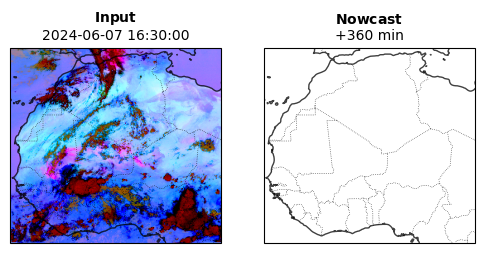

In [11]:
from matplotlib.animation import FuncAnimation

ens = 0
fontsize = 10

fig, axes = plt.subplots(1, 2, figsize=(6, 12), subplot_kw={'projection': ccrs.PlateCarree()})
axes = axes.flatten()
img_obs_frame = img_obs[0]
img_prd_frame = np.ones_like(img_obs_frame)  # Placeholder for the predicted image

# Initialize the image object
img_l = axes[0].imshow(img_obs_frame, origin='upper', extent=img_extent, transform=ccrs.PlateCarree())
img_r = axes[1].imshow(img_obs_frame, origin='upper', extent=img_extent, transform=ccrs.PlateCarree())
axes[0].set_title(r"$\bf{Input}$"+f"\n{time_input[0]}", fontsize=fontsize)

for ax in axes:
    ax.set_extent(img_extent, crs=ccrs.PlateCarree())
    ax.add_feature(cf.COASTLINE, alpha=0.75, color='black')
    ax.add_feature(cf.BORDERS, linestyle=':', alpha=0.75, color='black', linewidth=0.5)

# Function to update the frame in the animation
def update(frame):
    if frame < len(time_input):
        img_obs_frame = img_inp[frame]
        img_prd_frame = np.ones_like(img_obs_frame)  # Placeholder for the predicted image
        axes[0].set_title(r"$\bf{Input}$"+f"\n{time_input[frame]}", fontsize=fontsize)
    else:
        fr = min(frame - len(time_input), len(time_valid) - 1)
        img_obs_frame = img_obs[fr]
        img_prd_frame = img_prd[fr][ens]
        axes[0].set_title(r"$\bf{Observation}$"+f'\n{time_valid[fr]}', fontsize=fontsize)
        axes[1].set_title(r"$\bf{Nowcast}$"+f"\n+{(fr+1)*15} min", fontsize=fontsize)
    img_l.set_data(img_obs_frame)
    img_r.set_data(img_prd_frame)
    return img_l, img_r

ani = FuncAnimation(fig, update, frames=len(time_valid)+len(time_input)+1, interval=500, blit=False)


# Display the animation in the notebook
from IPython.display import HTML
HTML(ani.to_jshtml())


# # Save the animation as a GIF (optional)
# from matplotlib.animation import PillowWriter
# output_path = os.path.join(plt_dir, 'img_obs_animation.gif')
# ani.save(output_path, writer=PillowWriter(fps=2), dpi=300)